In [1]:
import pandas as pd
import cv2
import numpy as np
import matplotlib.pyplot as plt
import ast
import math
import os
from scipy.stats import multivariate_normal
from matplotlib import cm
from scipy.signal import argrelmin
import matplotlib.image as mpimg



## KDE class

In [2]:
class KDE:
    def __init__(self, kernel='gaussian'):
        self.kernel = kernel

    def _gaussian_kernel(self, u):
        return 1 / np.sqrt(2 * np.pi) * np.exp(-1 / 2 * u * u)

    def _box_kernel(self, u):
        return 0.5 if np.abs(u) <= 1 else 0

    def _triangular_kernel(self, u):
        return 1 - np.abs(u) if np.abs(u) <= 1 else 0

    def _kernel(self, u):
        if self.kernel == 'gaussian':
            return self._gaussian_kernel(u)
        elif self.kernel == 'box':
            return self._box_kernel(u)
        elif self.kernel == 'triangular':
            return self._triangular_kernel(u)
        else:
            raise ValueError('Unknown kernel.')

    def fit1D(self, data, h=None, num_points=100):
        x = np.linspace(np.min(data), np.max(data), num_points)
        if h is None:
            h = self._estimate_bandwidth_1D(data)
            print('estimated h : ',h)
        self.h = h
        # k = self._kernel(kernel_name)
        n = len(data)
        kde = np.zeros_like(x)
        for j in range(len(x)):
            for i in range(n):
                kde[j] += self._kernel((x[j] - data[i]) / h)
            kde[j] /= n * h
        return x, kde

    
    def fit(self, data, h=None, num_points=100):
        self.data = data

        if np.ndim(data)==1:
            return self.fit1D(data,h,num_points)
        
        if h is None:
            h = self._estimate_bandwidth(data)
        self.h = h

        min_val, max_val = np.min(data, axis=0), np.max(data, axis=0)
        linspace_values = [np.linspace(min_val[i], max_val[i], num_points) for i in range(data.shape[1])]
        meshgrid_values = np.meshgrid(*linspace_values)

        coordinates = np.vstack([dimension.flatten() for dimension in meshgrid_values]).T
        kde = np.zeros_like(coordinates[:, 0])

        # print('now fitting!')
        for i, coord in enumerate(coordinates):
            kde[i] = np.sum([self._kernel(np.linalg.norm((coord - data[j]) / h)) / (h**data.shape[1]) for j in range(data.shape[0])])

        kde_values = kde.reshape(meshgrid_values[0].shape)

        return meshgrid_values, kde_values

    # takes a lot of time (arounf 10 mins)
    
    
    def _estimate_bandwidth_1D(self, data):
        n = len(data)

        # Calculate the optimal bandwidth using MLCV
        # finding bandwidth in the range [-1,1] (can be changesd)
        
        bandwidths = 10 ** np.linspace(-1, 1, 100)
        log_likelihoods = []

        for bandwidth in bandwidths:
            log_likelihood = 0

            for i in range(n):
                # Leave-one-out cross-validation
                data_without_i = np.delete(data, i)
                kernel_sum = np.sum(np.exp(-0.5 * ((data[i] - data_without_i) / bandwidth) ** 2) / (bandwidth * np.sqrt(2 * np.pi)))
                log_likelihood += np.log(kernel_sum / (n - 1))

            log_likelihoods.append(log_likelihood)

        optimal_bandwidth = bandwidths[np.argmax(log_likelihoods)]
        return optimal_bandwidth

    
    def _estimate_bandwidth(self, data):

        n = len(data)
        bandwidths = 10 ** np.linspace(-1, 1, 100)
        log_likelihoods = []

        for bandwidth in bandwidths:
            log_likelihood = 0
            for i in range(n):
                data_without_i = np.delete(data, i, axis=0)
                kernel_sum = np.sum([self._kernel(np.linalg.norm((data[i] - data_without_i[j]) / bandwidth))
                    / (bandwidth**data.shape[1]) for j in range(data_without_i.shape[0])])

                log_likelihood += np.log(kernel_sum / (n - 1))

            log_likelihoods.append(log_likelihood)

        optimal_bandwidth = bandwidths[np.argmax(log_likelihoods)]
        return optimal_bandwidth
    
    def evaluate(self,x):
        if x.shape[0]==1:
            return self.evaluate1D(x)
        return np.sum([self._kernel(np.linalg.norm((x - self.data[j]) / self.h)) / (self.h**self.data.shape[1]) for j in range(self.data.shape[0])])
    
    def evaluate1D(self,x):
        ans = 0
        n = len(self.data)
        for i in range(n):
            ans += self._kernel((x - self.data[i]) / self.h)
        ans /= n * self.h
        return ans

        
    def plot_2d_density(self, meshgrid_values, kde_values, data):
        # print('plotting the dist.')
        plt.figure(figsize=(12, 8))
        plt.contourf(meshgrid_values[0], meshgrid_values[1], kde_values, cmap=cm.inferno, levels=20, alpha=0.85)
        plt.scatter(data[:, 0], data[:, 1], color='w', marker='.', label='Data Points')
        plt.xlabel('dimension 1')
        plt.ylabel('dimension 2')
        plt.title('Kernel Density Estimation in 2D')
        plt.legend()
        plt.show()
        
    def plot_1d_density(self, meshgrid_values, kde_values, data):
        plt.plot(meshgrid_values,kde_values, label='KDE')
        plt.fill_between(meshgrid_values, kde_values, color='skyblue', alpha=0.3)
        plt.scatter(data, np.zeros_like(data), color='black', label='Data Points', marker='.')
        plt.xlabel('x')
        plt.ylabel('p(x)')
        ttl = 'Kernel Density function for '+str(self.kernel)+' with h='+str(np.round(self.h,2))
        plt.title(ttl)
        plt.grid()
        plt.legend()
        plt.show()



In [3]:
df = pd.read_csv('./q4_data/CSV/TLBR_159.csv')
print(df)

     Unnamed: 0      Top-Left  Bottom-Right   Id
0             0    [365, 291]    [783, 362]    0
1             1    [802, 284]    [858, 342]    1
2             2    [873, 291]    [931, 345]    2
3             3   [1972, 280]   [2062, 335]    3
4             4    [363, 455]    [464, 520]    4
..          ...           ...           ...  ...
124         124   [355, 3104]   [706, 3179]  124
125         125   [728, 3090]  [1201, 3162]  125
126         126  [1221, 3093]  [1259, 3148]  126
127         127  [1279, 3090]  [1465, 3155]  127
128         128  [1489, 3097]  [1723, 3158]  128

[129 rows x 4 columns]


In [4]:
img = cv2.imread('./q4_data/images/152.jpg')

### function to visualize boxes

In [5]:
def visualize_bboxes(img):
  img_2 = img.copy()
  for index, rows in df.iterrows():
    top_left = (int(rows['Top-Left'].split(',')[0][1:]),int(rows['Top-Left'].split(',')[1][:-1]))
    bottom_right = (int(rows['Bottom-Right'].split(',')[0][1:]),int(rows['Bottom-Right'].split(',')[1][:-1]))
    # print(top_left)
    cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)

    plt.imshow(img_2)

### function to make connections according the updated dataframe

In [6]:
def make_connections(image,euclidean):
  
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  image_with_boxes = image_rgb.copy()

  for index, row in euclidean.iterrows():
      left = int(row['Left'][0])
      right = int(row['Right'][0])
      top = int(row['Top'][1])
      bottom = int(row['Bottom'][1])
      box_id = int(row['Id'])

      # print(row)
      
      width = right - left
      height = bottom - top

      top_left = (left, top)
      bottom_right = (right, bottom)

        # drawing rectangle arounf the sample
      cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

        # placing the label(with box id) on the corresponding box
      label_position = (left, top - 10)
      cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

        
      top_adjacent_id = int(row['Top_Box'][1])
      bottom_adjacent_id = int(row['Bottom_Box'][1])
      left_adjacent_id = int(row['Left_Box'][1])
      right_adjacent_id = int(row['Right_Box'][1])

      # print(top_adjacent_id)
      
      if top_adjacent_id != 0:
          # print(euclidean[(euclidean['Id'] == top_adjacent_id)])
          top_adjacent_row = euclidean[euclidean['Id'] == top_adjacent_id].iloc[0]
          top_adjacent_center = int(top_adjacent_row['Bottom'][0]) , int(top_adjacent_row['Bottom'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 0, 255), 2)

      if bottom_adjacent_id != 0:
          bottom_adjacent_row = euclidean[euclidean['Id'] == bottom_adjacent_id].iloc[0]
          bottom_adjacent_center = int(bottom_adjacent_row['Top'][0]) , int(bottom_adjacent_row['Top'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)), (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 0, 255), 2)

      if left_adjacent_id != 0:
          left_adjacent_row = euclidean[euclidean['Id'] == left_adjacent_id].iloc[0]
          left_adjacent_center = int(left_adjacent_row['Right'][0]) , int(left_adjacent_row['Right'][1])
          cv2.line(image_with_boxes, (int(left), int(top) + height // 2), (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 0, 255), 2)

      if right_adjacent_id != 0:
          right_adjacent_row = euclidean[euclidean['Id'] == right_adjacent_id].iloc[0]
          right_adjacent_center = int(right_adjacent_row['Left'][0]) , int(right_adjacent_row['Left'][1])
          cv2.line(image_with_boxes, (int(right), int(top) + height // 2), (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 0, 255), 2)

  return image_with_boxes

In [7]:
def convert_string_to_list(string):
    # Remove brackets and split by comma
    values = string.strip('[]').split(',')
    
    # Convert values to integers
    try:
        a = int(values[0])
        b = int(values[1])
        return [a, b]
    except (ValueError, IndexError):
        return None  # Handle conversion errors or invalid input


### Function to calculate euclidean distance between 2 points

In [8]:
def calcDistance(point1,point2):
    euclidean_distance = math.sqrt((point1[0] - point2[0])**2 + (point1[1] - point2[1])**2)
    return euclidean_distance

In [9]:
def draw_horizontal_lines(image_path, coordinates):
    # Load the image
    img = mpimg.imread(image_path)

    # Plot the image
    plt.imshow(img)

    # Draw horizontal lines at specified coordinates
    for coord in coordinates:
        plt.axhline(y=coord, color='red', linestyle='--')

    # Display the image with horizontal lines
    plt.show()


### function to check if a line connecting the given 2 points crosses any line in para_sep

In [10]:
# checks if Line connecting val1, val2 crosses any of the lines in para_sep (in 1D)
def crosses(val1,val2,para_sep):
    # print('recieved : ',v1)
    v1 = min(val1,val2)
    v2 = max(val1,val2)
    if v1>v2:
        print('huh? ',v1,v2)
    for val in para_sep:
        if val<=v2 and val>=v1:
            return 1        
    return 0

In [11]:
# performs KDE with respect to y axis and estimates possible horizontal lines dividing paragraphs
def getSections(euclid_df,h=None):
    if h.all()==None:
        h=75 # best hyperparameter
    else:
        temp=h[0]
        h=temp
        
    L = euclid_df['Left'].values
    R = euclid_df['Right'].values
    L = np.vstack(L)
    R = np.vstack(R)
    L = L[:,0]
    R = R[:,0]

    freq = (R-L)
    k = (np.min(freq))
    freq = (freq//k).astype(int)

    ar = euclid_df['Left'].values
    ar = np.vstack(ar)
    ar = ar[:,1]
    X = np.repeat(ar, freq)
    # print('new shape of X : ',X.shape)
    
    # creating and fitting KDE
    kde = KDE(kernel='gaussian')
    meshgrid_values, kde_values = kde.fit(data=X,h=h,num_points=3276)

    # plotting the results
    # kde.plot_1d_density(meshgrid_values,kde_values,X)
    
    ind = argrelmin(kde_values)
    ind = np.array(ind)
    ind = ind.reshape(-1)
    filtered_ind = []
    th = min(100,ind[0]-2,3276-ind[-1]-2)

    for i in ind:
        slope1 = (kde_values[i-th]-kde_values[i])/kde_values[i]
        slope2 = (kde_values[i]-kde_values[i+th])/kde_values[i]
        
        # print('slope at ',meshgrid_values[i].round(2),' : ',slope)
        if slope1>0.01 and slope2<0.01:
            filtered_ind.append(i)
        # else:
        #     print('false minima found!')

    axes[0,0].plot(meshgrid_values, kde_values, label='Kernel Density Estimation')
    axes[0,0].fill_between(meshgrid_values, kde_values, color='skyblue', alpha=0.3)

    # List of x-axis values for vertical lines
    vertical_lines_x = meshgrid_values[filtered_ind]

    # Plot vertical lines at specified x-axis values
    for x_value in vertical_lines_x:
        axes[0,0].axvline(x=x_value, color='red', linestyle='--')

    # Show the plot
    axes[0,0].set_xlabel('x')
    axes[0,0].set_ylabel('Density(x)')
    axes[0,0].set_title('Density with respect to Y-axis')
    axes[0,0].grid()
    print('horizontal sections : ',np.round(meshgrid_values[filtered_ind],2))
    vertical_lines_x = meshgrid_values[filtered_ind]
    return vertical_lines_x


In [12]:
# performs KDE with respect to x axis and estimates possible horizontal lines dividing columns
def getColumns(euclid_df,h=None):
    
    if h.all()==None:
        h=200 # best hyperparameter
    else:
        temp = h[1]
        h = temp

    L = euclid_df['Left'].values
    R = euclid_df['Right'].values
    L = np.vstack(L)
    R = np.vstack(R)
    L = L[:,0]
    R = R[:,0]

    freq = (R-L)
    k = (np.min(freq))
    freq = (freq//k).astype(int)

    ar = euclid_df['Top'].values
    ar = np.vstack(ar)
    ar = ar[:,0]
    X = np.repeat(ar, freq)
    # print('new shape of X : ',X.shape)
    
    # creating and fitting KDE
    kde = KDE(kernel='gaussian')
    meshgrid_values, kde_values = kde.fit(data=X,h=h,num_points=3276)

    # plotting the results
    # kde.plot_1d_density(meshgrid_values,kde_values,X)
    
    ind = argrelmin(kde_values)
    ind = np.array(ind)
    ind = ind.reshape(-1)
    filtered_ind = []
    if len(ind)>0:
        th = min(1,ind[0]-2,3276-ind[-1]-2)

    for i in ind:
        slope1 = (kde_values[i-th]-kde_values[i])/kde_values[i]
        slope2 = (kde_values[i]-kde_values[i+th])/kde_values[i]
        
        # print('slope at ',meshgrid_values[i].round(2),' : ',slope)
        if slope1>0.0 and slope2<0.0:
            filtered_ind.append(i)
        # else:
        #     # print('slopes : ',slope1,slope2)
        #     print('false minima found!')

    axes[0,1].plot(meshgrid_values, kde_values, label='Kernel Density Estimation')
    axes[0,1].fill_between(meshgrid_values, kde_values, color='skyblue', alpha=0.3)

    # List of x-axis values for vertical lines
    vertical_lines_x = meshgrid_values[filtered_ind]

    # Plot vertical lines at specified x-axis values
    for x_value in vertical_lines_x:
        axes[0,1].axvline(x=x_value, color='red', linestyle='--')

    # Show the plot
    axes[0,1].set_xlabel('x')
    axes[0,1].set_ylabel('Density(x)')
    axes[0,1].set_title('Density with respect to X-axis')
    axes[0,1].grid()
    print('vertical sections : ',np.round(meshgrid_values[filtered_ind],2))
    vertical_lines_x = meshgrid_values[filtered_ind]
    return vertical_lines_x


In [13]:
# finds the thresholds using KDE and adds connections columns to the dataframe
def convert_dataframe(df,h=None):
    n = len(df)
    euclid_df = pd.DataFrame()  # Create an empty DataFrame
    
    # Extract and convert 'Id' column
    euclid_df['Id'] = df['Id']
    
    # Define a function to convert the string columns to lists of integers
    def convert_string_to_list(string):
        # Remove brackets and split by comma
        values = string.strip('[]').split(',')
        
        # Convert values to integers
        try:
            l = int(values[0])
            t = int(values[1])
            return [l, t]
        except (ValueError, IndexError):
            return None  # Handle conversion errors or invalid input
    
    # Apply the conversion function to 'Top-Left' and 'Bottom-Right' columns
    a = df['Top-Left'].apply(convert_string_to_list)
    A = np.array(a.tolist())
    l = A[:,0]
    t = A[:,1]

    a = df['Bottom-Right'].apply(convert_string_to_list)
    A = np.array(a.tolist())
    r = A[:,0]
    b=  A[:,1]

    left = np.column_stack((l,(t+b)/2))
    right = np.column_stack((r,(t+b)/2))
    top = np.column_stack(((l+r)/2,t))
    bottom = np.column_stack(((l+r)/2,b))
    
    # print(left.tolist())
    
    euclid_df['Left'] = left.tolist()
    euclid_df['Right'] = right.tolist()
    euclid_df['Top'] = top.tolist()
    euclid_df['Bottom'] = bottom.tolist()
    
    
    # applying KDE and getting sections
    para_sep = getSections(euclid_df=euclid_df,h=h)
    col_sep = getColumns(euclid_df=euclid_df,h=h)
    print('Paragraphs and columns found! Now connecting words...')
    
    
    
    image_path = './q4_data/images/'+str(image_number)+'.jpg'
    # draw_horizontal_lines(image_path,para_sep)   
    img = mpimg.imread(image_path)
    axes[1,0].imshow(img)
    if image_number==201:
        col_sep=col_sep-150
    for coord in para_sep:
        axes[1,0].axhline(y=coord, color='blue', linestyle='--')
    
    for coord in col_sep:
        axes[1,0].axvline(x=coord, color='blue', linestyle='--')

    
    euclid_df['Top_Box'] = None
    euclid_df['Bottom_Box'] = None
    euclid_df['Left_Box'] = None
    euclid_df['Right_Box'] = None
    
    e = 100
    
    
    lb = np.array([])
    rb = np.array([])
    tb = np.array([])
    bb = np.array([])
    
    
    for i1,r1 in euclid_df.iterrows():
        min_id = 0
        min_dist = 10000000
        for i2,r2 in euclid_df.iterrows():
            if(r1['Id']!=r2['Id']):
                dst = calcDistance(r2['Right'],r1['Left'])
                d1 = calcDistance(r1['Top'],r2['Top'])
                d2 = calcDistance(r1['Bottom'],r2['Bottom'])
                if(dst<=e and dst<=min_dist and not(crosses(r2['Top'][0],r1['Top'][0],col_sep))):
                    min_dist = dst
                    min_id = r2['Id']
            # else:
            #     print('i1 = ',i1,' i2 = ',i2)
        if min_dist==10000000:
            min_dist=-1
        lb = np.append(lb,[min_dist,min_id])
    lb = lb.reshape(n,2)
    euclid_df['Left_Box'] = lb.tolist()
    
    for i1,r1 in euclid_df.iterrows():
        min_id = 0
        min_dist = 10000000
        for i2,r2 in euclid_df.iterrows():
            if(r1['Id']!=r2['Id']):
                dst = calcDistance(r2['Left'],r1['Right'])
                d1 = calcDistance(r1['Top'],r2['Top'])
                d2 = calcDistance(r1['Bottom'],r2['Bottom'])
                if(dst<=e and dst<=min_dist and not(crosses(r1['Top'][0],r2['Top'][0],col_sep))):
                    min_dist = dst
                    min_id = r2['Id']
            # else:
                # print('i1 = ',i1,' i2 = ',i2)
        if min_dist==10000000:
            min_dist=-1
        rb = np.append(rb,[min_dist,min_id])
    rb = rb.reshape(n,2)
    euclid_df['Right_Box'] = rb.tolist()
    
    for i1,r1 in euclid_df.iterrows():
        min_id = 0
        min_dist = 10000000
        for i2,r2 in euclid_df.iterrows():
            if(r1['Id']!=r2['Id']):
                dst = calcDistance(r2['Bottom'],r1['Top'])
                d1 = calcDistance(r1['Right'],r2['Right'])
                d2 = calcDistance(r1['Left'],r2['Left'])
                if(dst<=e and dst<=min_dist and not(crosses(r1['Left'][1],r2['Left'][1],para_sep))):
                    min_dist = dst
                    min_id = r2['Id']
            # else:
                # print('i1 = ',i1,' i2 = ',i2)

        if min_dist==10000000:
            min_dist=-1
        tb = np.append(tb,[min_dist,min_id])
    tb = tb.reshape(n,2)
    euclid_df['Top_Box'] = tb.tolist()

    for i1,r1 in euclid_df.iterrows():
        min_id = 0
        min_dist = 10000000
        for i2,r2 in euclid_df.iterrows():
            if(r1['Id']!=r2['Id']):
                dst = calcDistance(r2['Top'],r1['Bottom'])
                d1 = calcDistance(r1['Right'],r2['Right'])
                d2 = calcDistance(r1['Left'],r2['Left'])
                if(dst<=e and dst<=min_dist and not(crosses(r2['Left'][1],r1['Left'][1],para_sep))):
                    min_dist = dst
                    min_id = r2['Id']
            # else:
                # print('i1 = ',i1,' i2 = ',i2)
        if min_dist==10000000:
            min_dist=-1
        bb = np.append(bb,[min_dist,min_id])
    bb = bb.reshape(n,2)
    euclid_df['Bottom_Box'] = bb.tolist()


    
    
    return euclid_df



## Test Run : for single image
- change dataframe path accordingly
- run the next 5 frames sequentially to get output for desired image
- run the 6th cell by changing the image name according to the image number chosen

In [332]:
path = './q4_data/CSV/TLBR_152.csv'
df = pd.read_csv(path)
euclid_df = convert_dataframe(df)

horizontal sections :  [ 750.52 1342.4  1625.84 2134.36 2853.13 3059.69]
horizontal sections :  []
Paragraphs and columns found! Now connecting words...


In [333]:
L = euclid_df['Left'].values
R = euclid_df['Right'].values
L = np.vstack(L)
R = np.vstack(R)
L = L[:,0]
R = R[:,0]

freq = (R-L)
k = (np.min(freq))
freq = (freq//k).astype(int)

ar = euclid_df['Left'].values
ar = np.vstack(ar)
ar = ar[:,1]

X = np.repeat(ar, freq)
print('new shape of X : ',X.shape)

new shape of X :  (1064,)


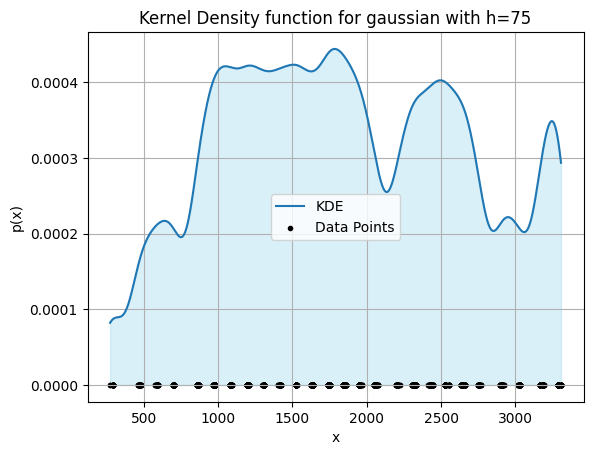

evaluation at point  [4.9]  :  [6.60831039e-08]


In [334]:
# creating and fitting KDE
kde = KDE(kernel='gaussian')
meshgrid_values, kde_values = kde.fit(data=X,h=75,num_points=3276)

# plotting the results
kde.plot_1d_density(meshgrid_values,kde_values,X)

# evaluating at a point
p = np.array([4.9])
print('evaluation at point ',p,' : ',kde.evaluate(p))

In [335]:
th = 100
ind = argrelmin(kde_values)
ind = np.array(ind)
ind = ind.reshape(-1)
filtered_ind = []

for i in ind:
    slope1 = (kde_values[i-th]-kde_values[i])/kde_values[i]
    slope2 = (kde_values[i]-kde_values[i+th])/kde_values[i]
    
    # print('slope at ',meshgrid_values[i].round(2),' : ',slope)
    if slope1>0.01 and slope2<0.01:
        filtered_ind.append(i)
        print(slope1, slope2)
    else:
        print('false minima found!')

print(np.round(meshgrid_values[filtered_ind],2))

0.1055427463655104 -0.38176596539915125
false minima found!
0.014557677163986519 -0.012605160360747986
0.019478846807268566 -0.04328454556720104
0.24598286678269604 -0.2278810713146485
0.3095000287037841 -0.0895036888430057
0.09352723400659463 -0.33010272782315625
[ 750.52 1342.4  1625.84 2134.36 2853.13 3059.69]


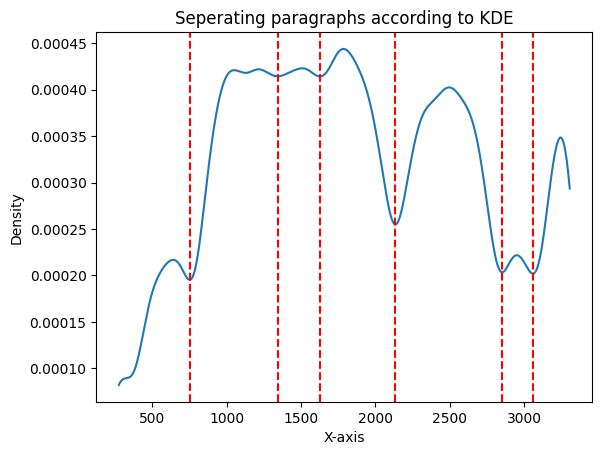

In [336]:
plt.plot(meshgrid_values, kde_values, label='Kernel Density Estimation')

# List of x-axis values for vertical lines
vertical_lines_x = meshgrid_values[filtered_ind]

# Plot vertical lines at specified x-axis values
for x_value in vertical_lines_x:
    plt.axvline(x=x_value, color='red', linestyle='--')

# Show the plot
plt.xlabel('X-axis')
plt.ylabel('Density')
plt.title('Seperating paragraphs according to KDE')
plt.show()


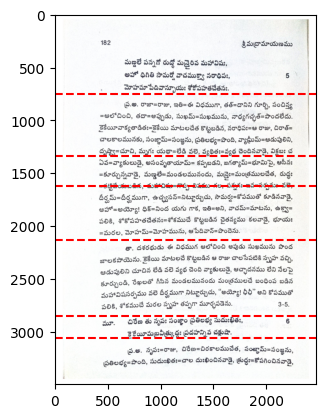

In [153]:
image_path = './q4_data/images/152.jpg'
draw_horizontal_lines(image_path,vertical_lines_x)

### Function to perform the whole process on a given image number

In [14]:
def connectImagewithThresholding(img_number,h=None):

    image_path = './q4_data/images/'+str(img_number)+'.jpg'
    df_path = './q4_data/CSV/TLBR_'+str(img_number)+'.csv'

    img = cv2.imread(image_path)
    df = pd.read_csv(df_path)
    
    euclid_df = convert_dataframe(df=df,h=h)
    new_image = make_connections(img,euclid_df)
    
    axes[1,1].imshow(new_image)
    cv2.imwrite('connected_image.png',new_image)
    cv2.imwrite('your_image_filename.png', new_image)

    tmp = './q4_output_from_assignment_2/'+str(img_number)+'.jpg'
    img1 = cv2.imread(tmp)
    img2 = new_image

    height = max(img1.shape[0], img2.shape[0])
    img1 = cv2.resize(img1, (int(img1.shape[1] * height / img1.shape[0]), height))
    img2 = cv2.resize(img2, (int(img2.shape[1] * height / img2.shape[0]), height))
    combined_img = np.concatenate((img1, img2), axis=1)
    text1 = "Assignment2 Result"
    text2 = "KDE Result"
    canvas = np.zeros((height + 60, combined_img.shape[1], 3), dtype=np.uint8)
    canvas[:height, :] = combined_img
    cv2.putText(canvas, text1, (10, height + 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(canvas, text2, (10 + img1.shape[1], height + 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.axis('off')  # Hide axis labels
    plt.show()
    final_name = './Comparison of Results from previous assignment/comp_img_'+str(img_number)+'.jpg'
    cv2.imwrite(final_name,canvas)

    # name = './outputs/'+str(img_number)+'_output.pdf'
    # plt.savefig(name)



## Sample use of the above function

new shape of X :  (2659,)
false minima found!
horizontal sections :  [ 327.14  706.3   998.82 1675.17 2616.09]
new shape of X :  (2659,)
horizontal sections :  [1413.62]
Paragraphs and columns found! Now connecting words...


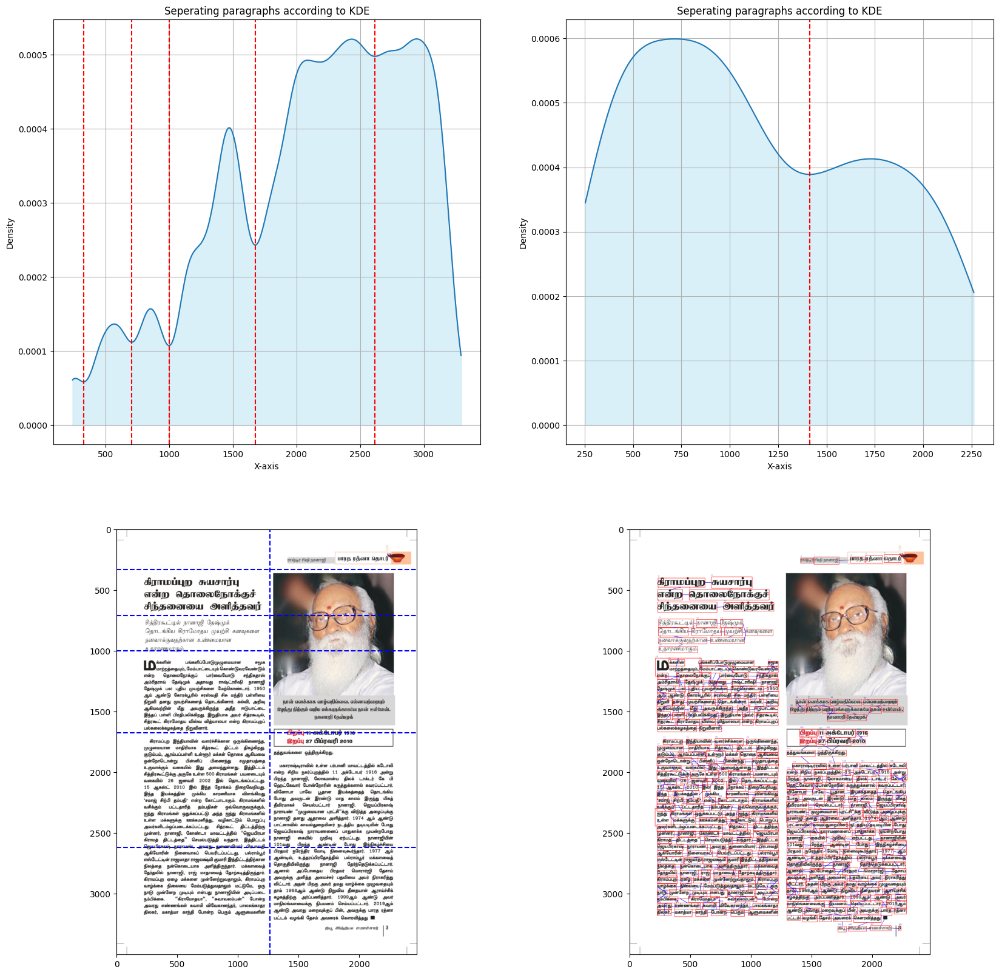

In [327]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 201
connectImagewithThresholding(image_number)

# Varying Hyperparameters for 4 images

### Image 159

- h1 = 50, h2=100

horizontal sections :  [ 398.36  664.02 1144.29 1477.44 1741.37 2212.12 2471.72 2723.54]
vertical sections :  [ 677.98 1237.38 1793.83]
Paragraphs and columns found! Now connecting words...


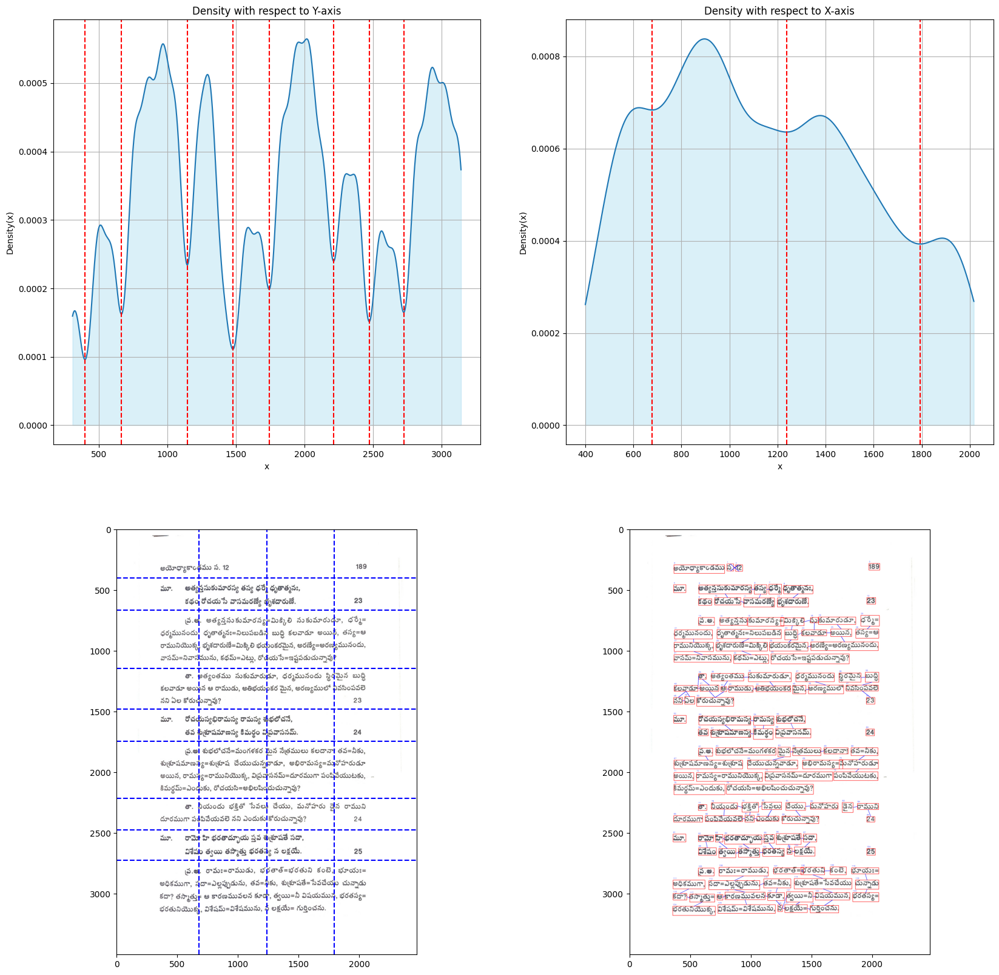

In [374]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 159
h=np.array([50,100])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 150

horizontal sections :  [ 637.2  1146.88 1477.44 1704.16 2223.37 2487.3  2694.12]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


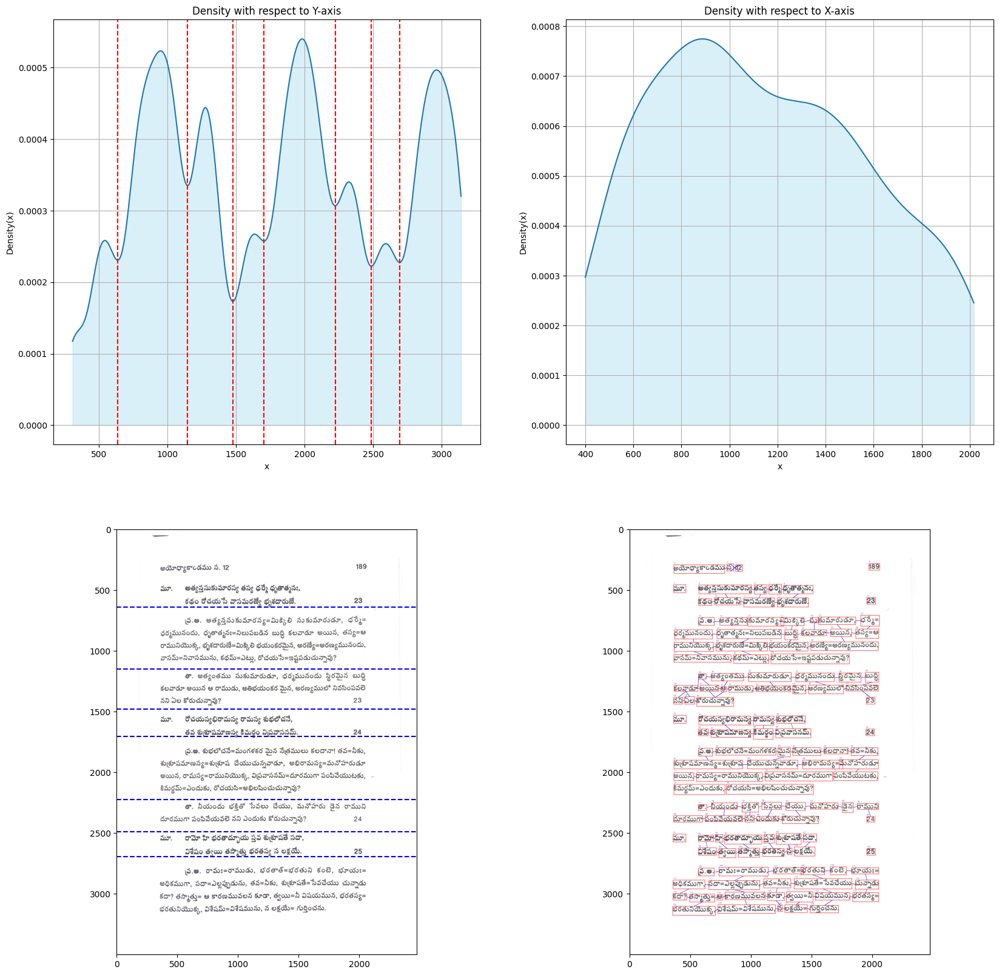

In [375]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 159
h=np.array([75,150])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 200

horizontal sections :  [ 637.2  1146.88 1477.44 1704.16 2223.37 2487.3  2694.12]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


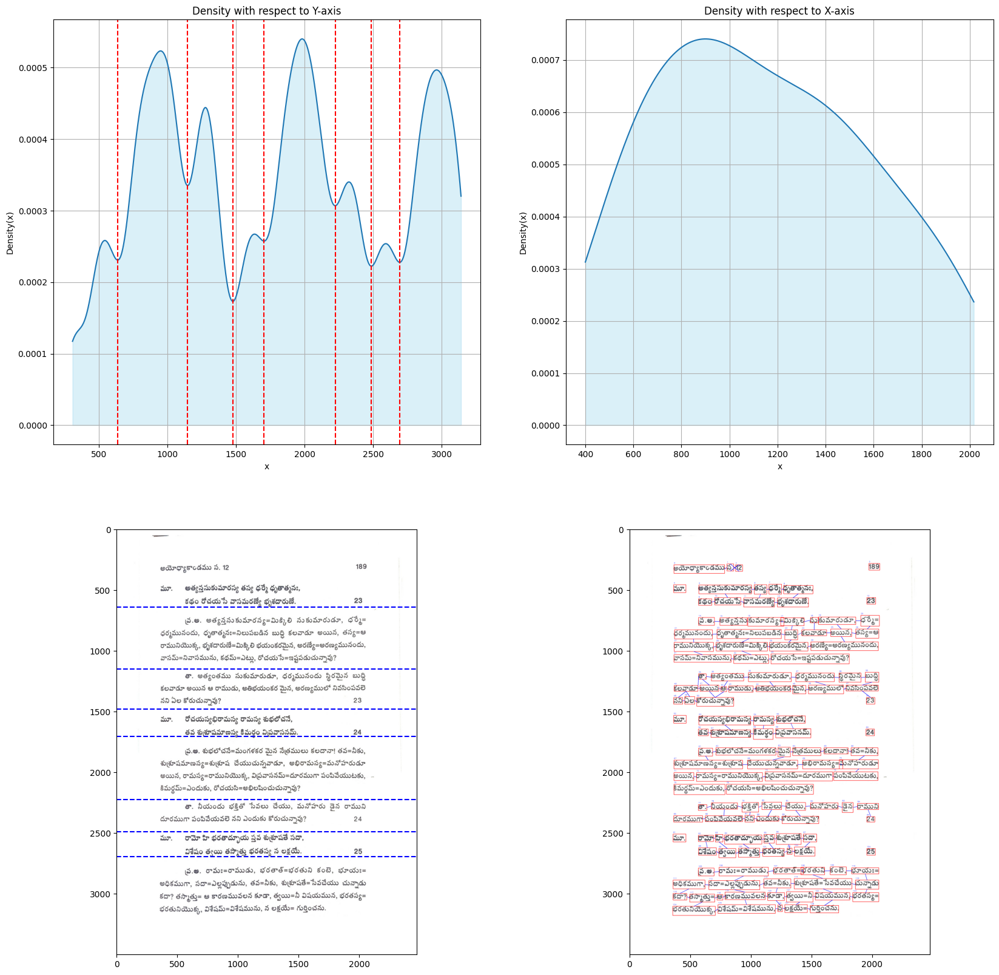

In [376]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 159
h=np.array([75,200])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 100, h2 = 250

horizontal sections :  [1159.   1499.08 2537.49]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


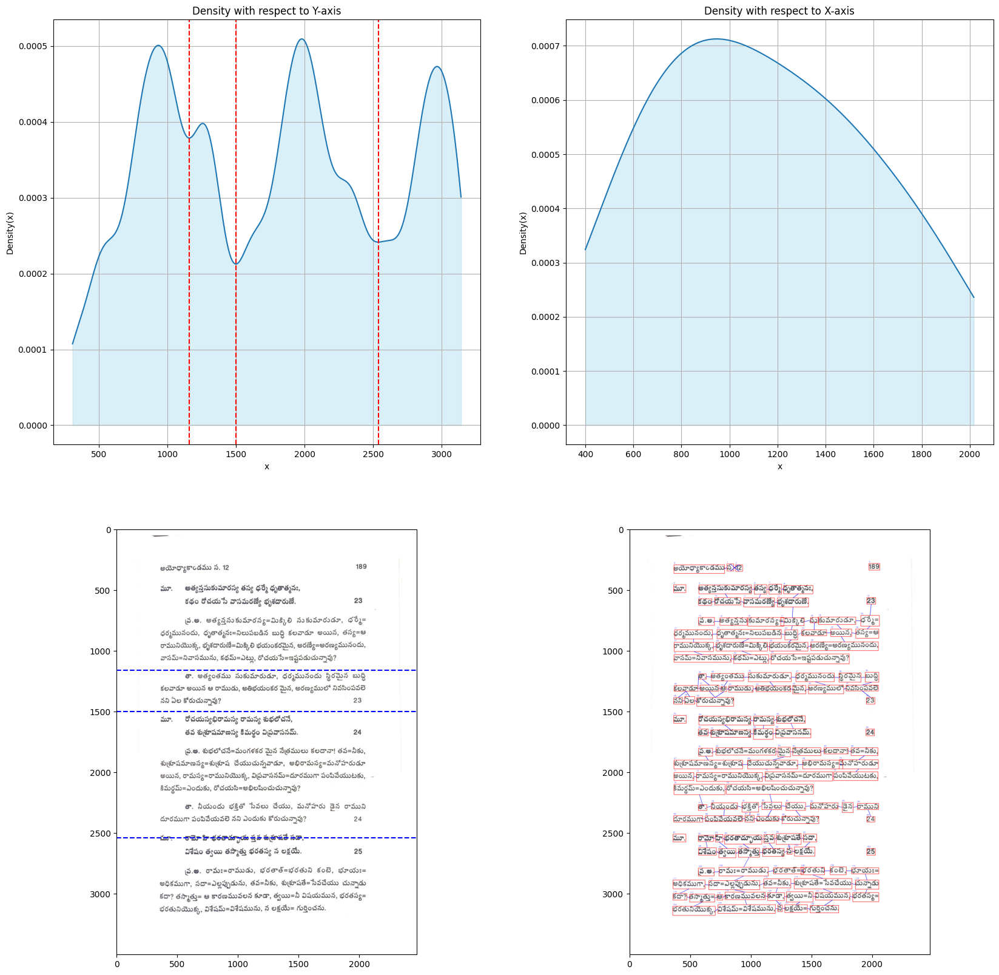

In [377]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 159
h=np.array([100,250])
connectImagewithThresholding(img_number=image_number,h=h)

### Image 152

- h1 = 50, h2=100

horizontal sections :  [ 371.68  775.53 1138.63 1358.15 1589.71 1677.71 2133.43 2834.61 3091.18]
vertical sections :  [ 802.55 1289.13 1692.13]
Paragraphs and columns found! Now connecting words...


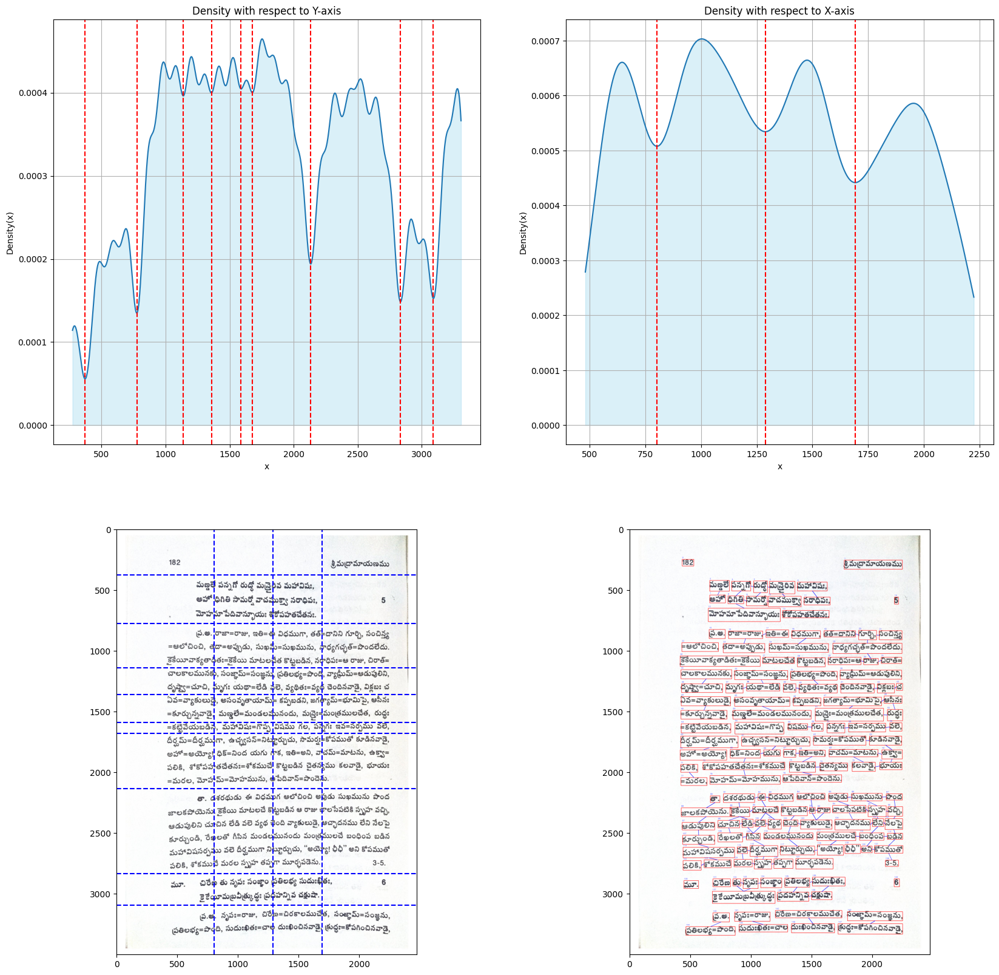

In [378]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 152
h=np.array([50,100])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 150

horizontal sections :  [ 750.52 1342.4  1625.84 2134.36 2853.13 3059.69]
vertical sections :  [1295.52 1729.4 ]
Paragraphs and columns found! Now connecting words...


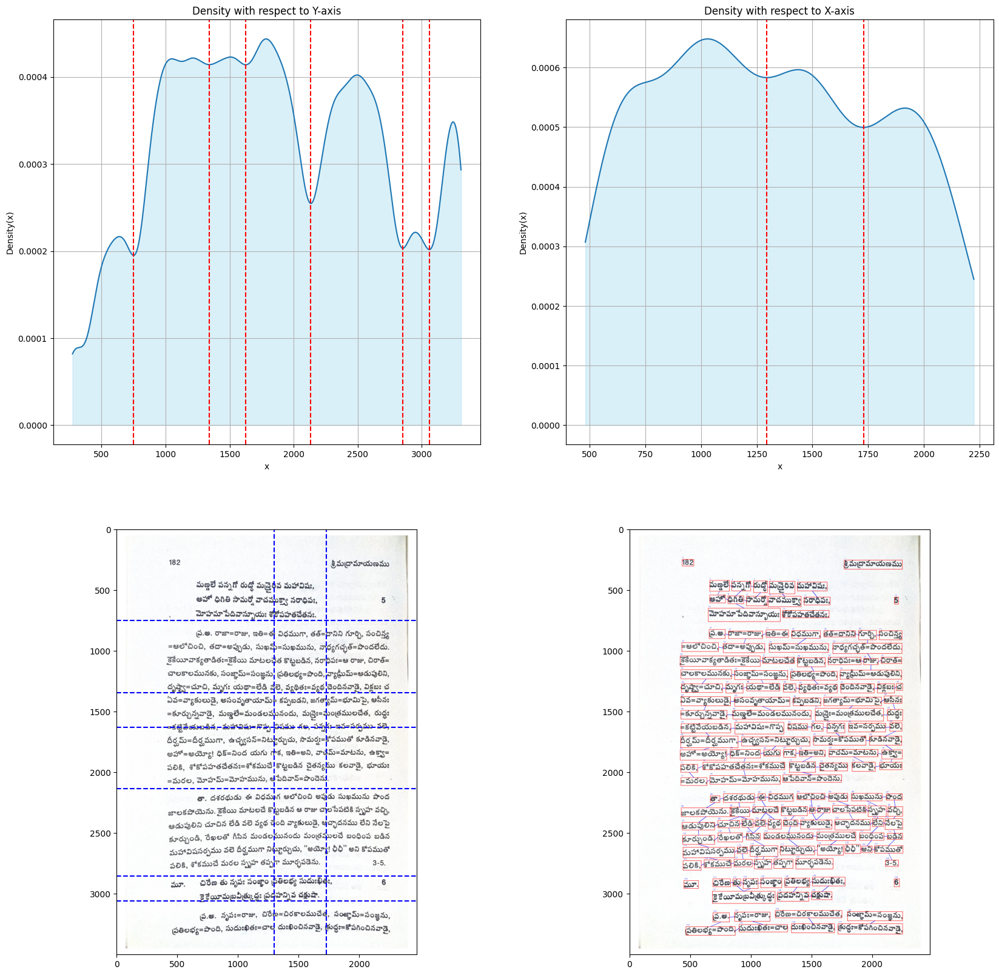

In [379]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 152
h=np.array([75,150])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 200

horizontal sections :  [ 750.52 1342.4  1625.84 2134.36 2853.13 3059.69]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


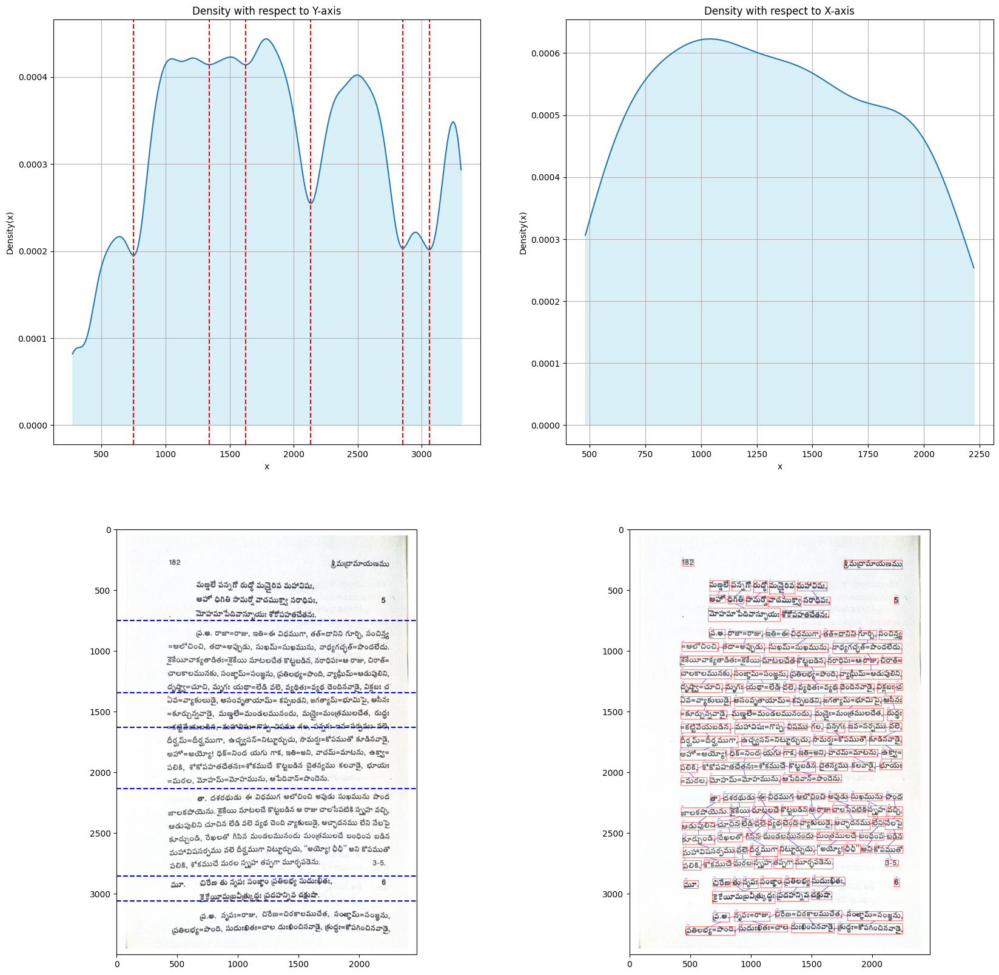

In [380]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 152
h=np.array([75,200])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 100, h2 = 250

horizontal sections :  [2137.13]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


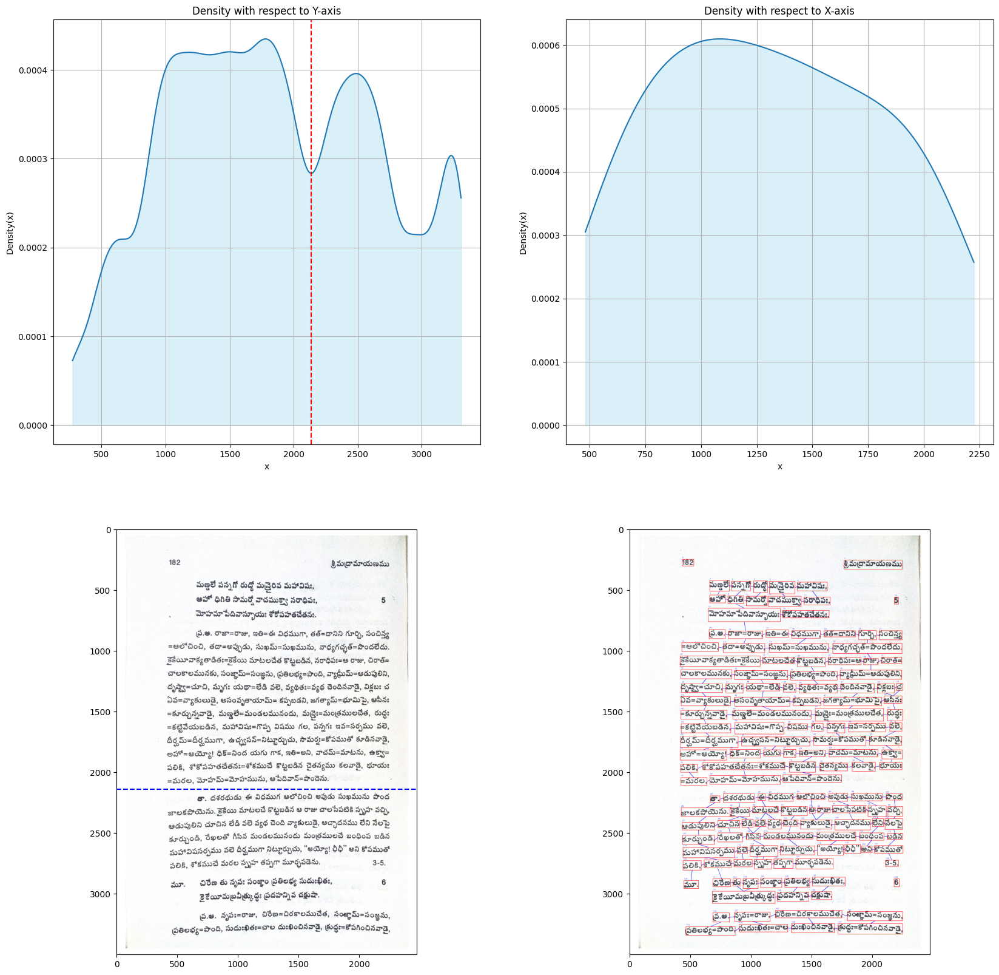

In [381]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 152
h=np.array([100,250])
connectImagewithThresholding(img_number=image_number,h=h)

### Image 145

- h1 = 50, h2=100

horizontal sections :  [ 718.44 1099.14 1517.73 2286.36 2613.83 2990.02]
vertical sections :  [ 578.02 1151.23 1534.12 1919.29]
Paragraphs and columns found! Now connecting words...


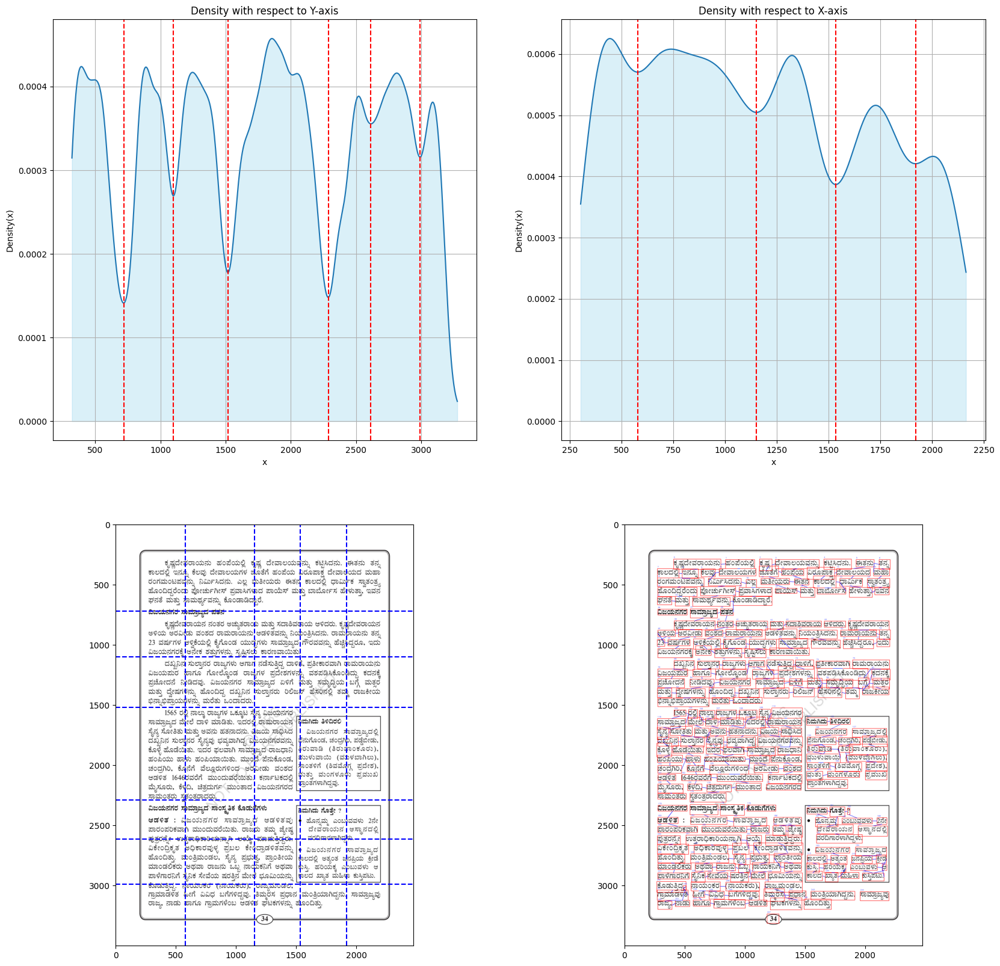

In [382]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 145
h=np.array([50,100])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 150

horizontal sections :  [ 710.32 1095.53 1521.34 2294.47]
vertical sections :  [1150.66 1568.78]
Paragraphs and columns found! Now connecting words...


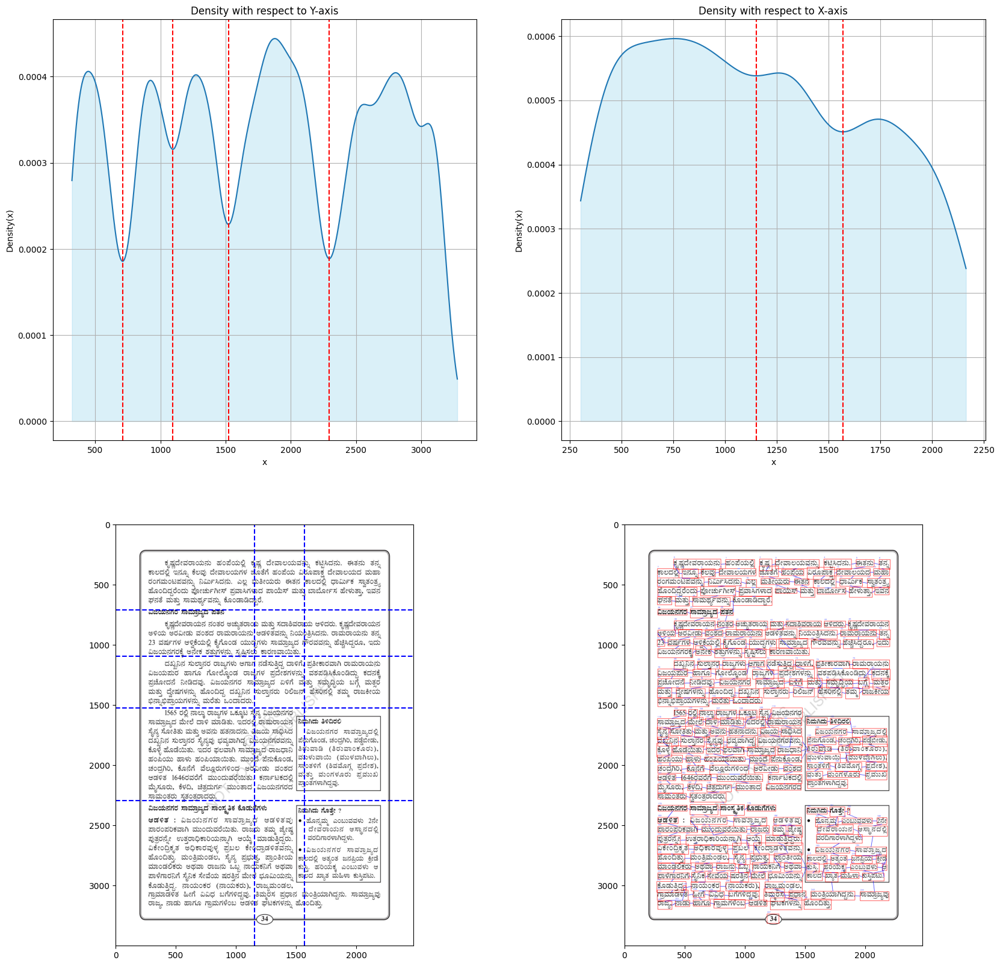

In [383]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 145
h=np.array([75,150])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 200

horizontal sections :  [ 710.32 1095.53 1521.34 2294.47]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


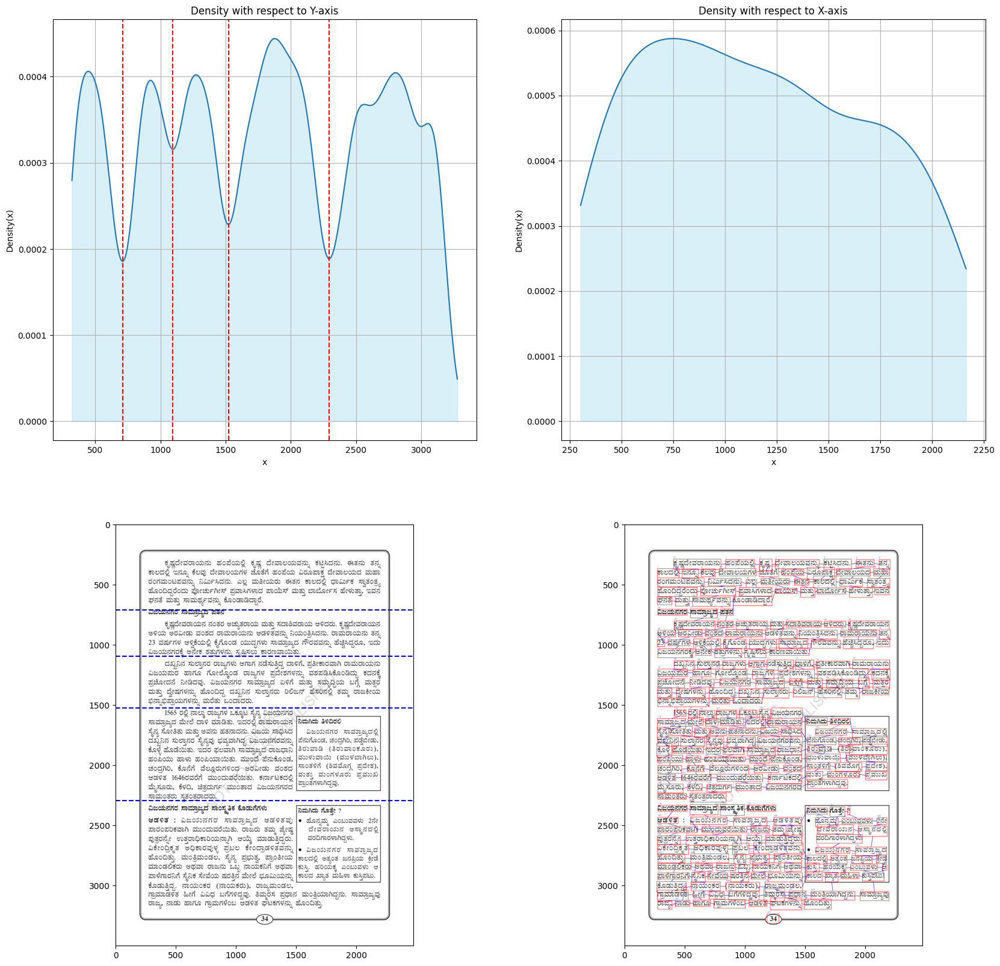

In [384]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 145
h=np.array([75,200])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 100, h2 = 250

horizontal sections :  [ 706.71 1091.93 1526.76 2299.89]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


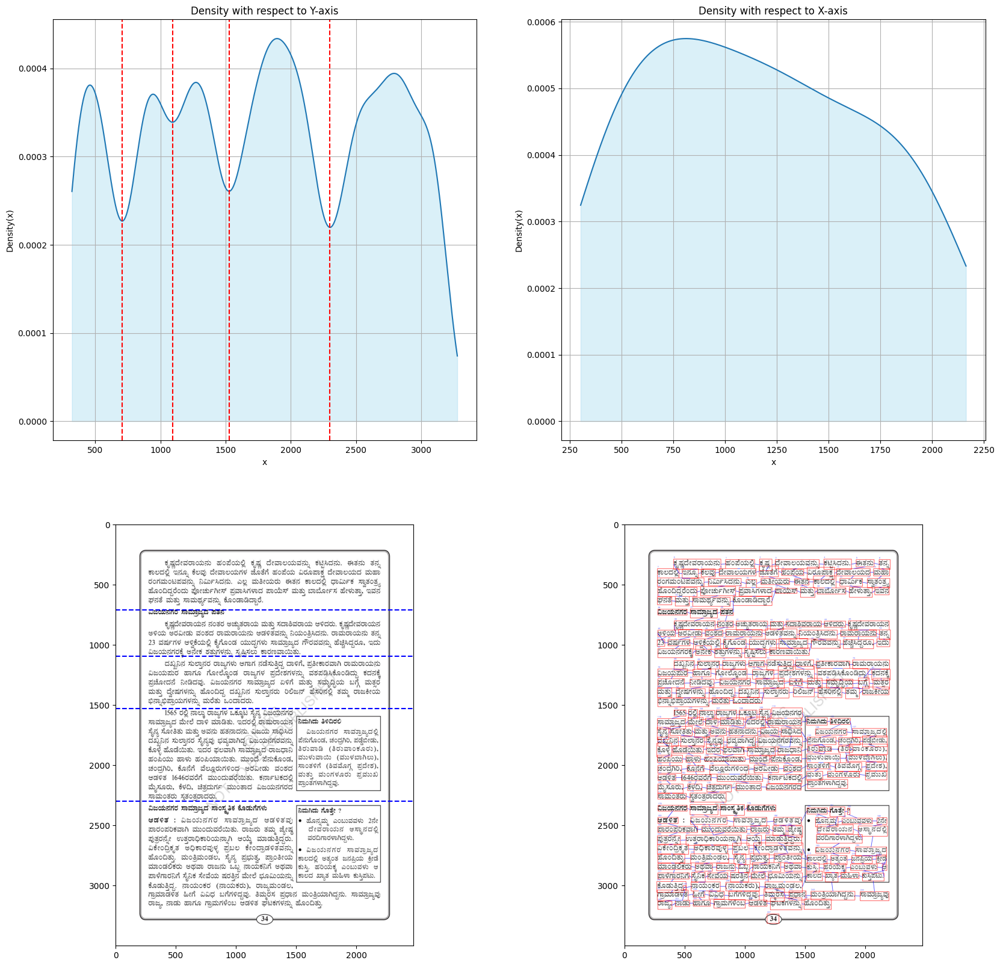

In [385]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 145
h=np.array([100,250])
connectImagewithThresholding(img_number=image_number,h=h)

### Image 68

- h1 = 50, h2=100

horizontal sections :  [ 212.13  763.38 1325.39 1687.03 2018.37 2207.01 2591.13]
vertical sections :  [ 620.68 1285.98 2012.26]
Paragraphs and columns found! Now connecting words...


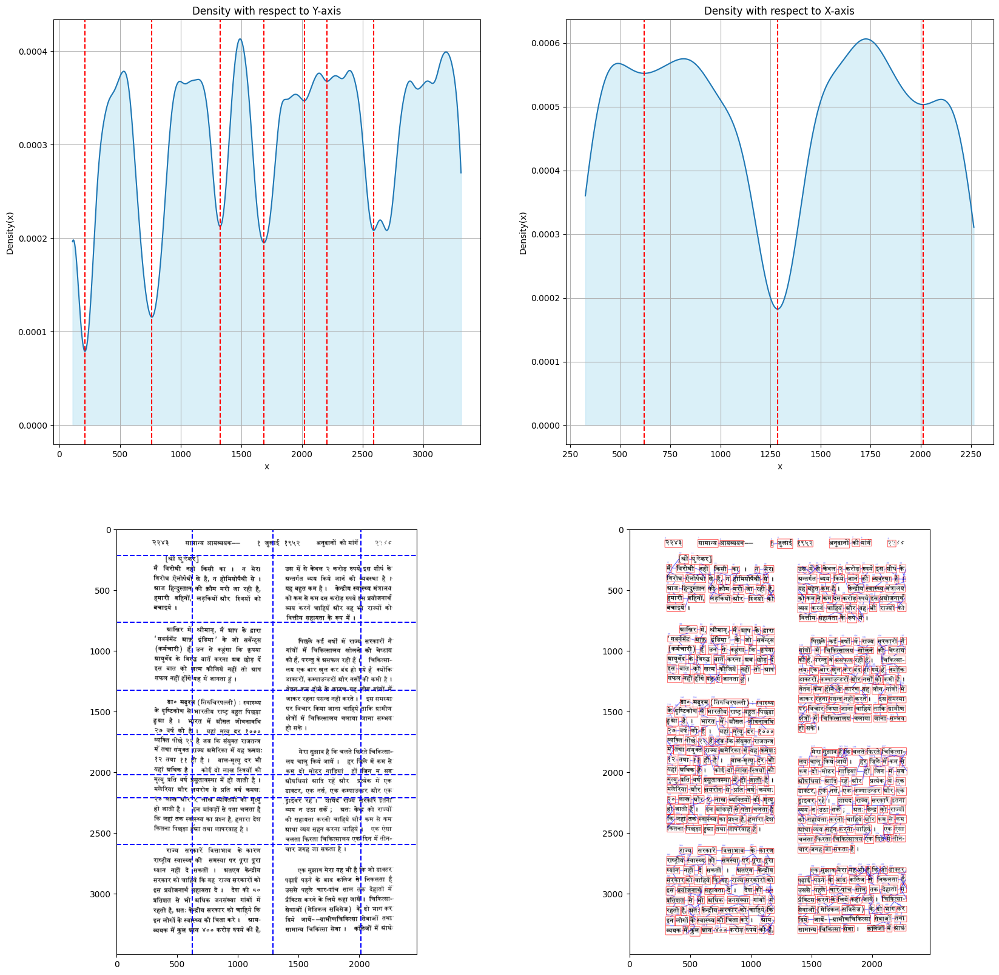

In [386]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 68
h=np.array([50,100])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 150

horizontal sections :  [ 198.44  760.45 1321.48 1690.94 2646.84]
vertical sections :  [1278.88]
Paragraphs and columns found! Now connecting words...


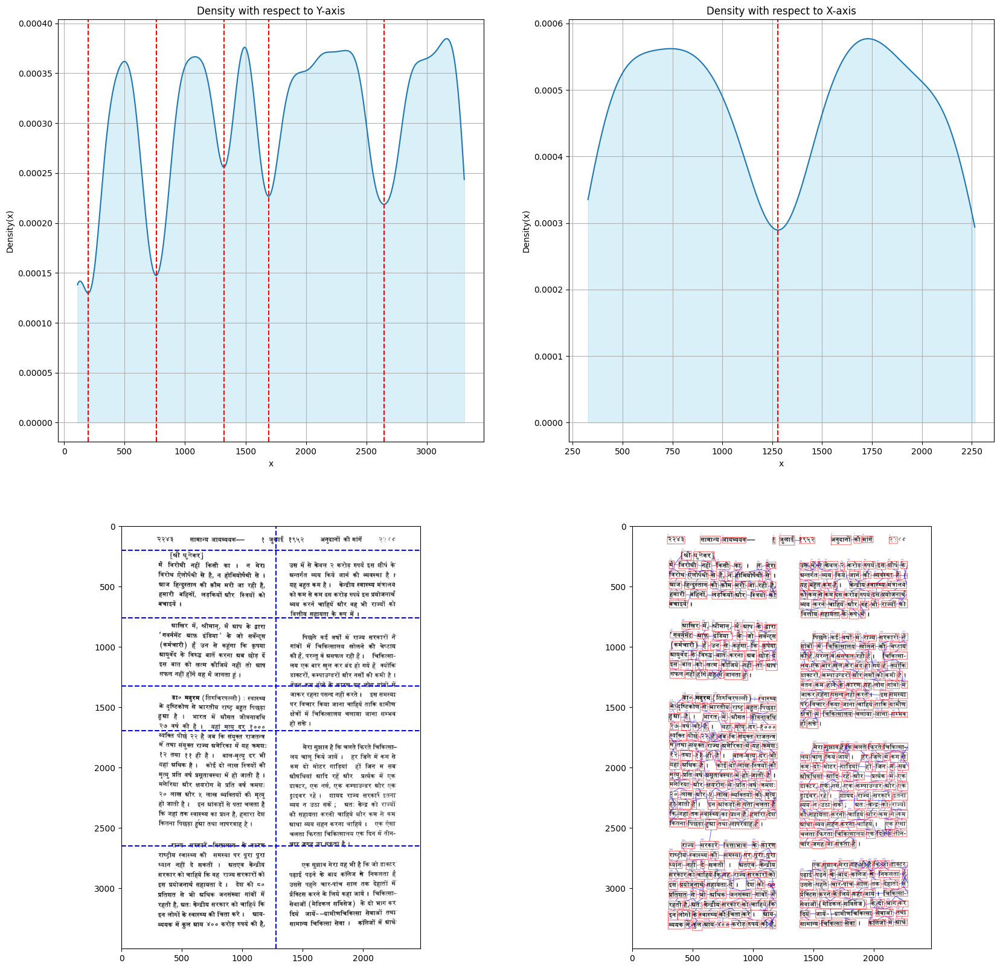

In [387]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 68
h=np.array([75,150])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 75, h2 = 200

horizontal sections :  [ 198.44  760.45 1321.48 1690.94 2646.84]
vertical sections :  [1271.78]
Paragraphs and columns found! Now connecting words...


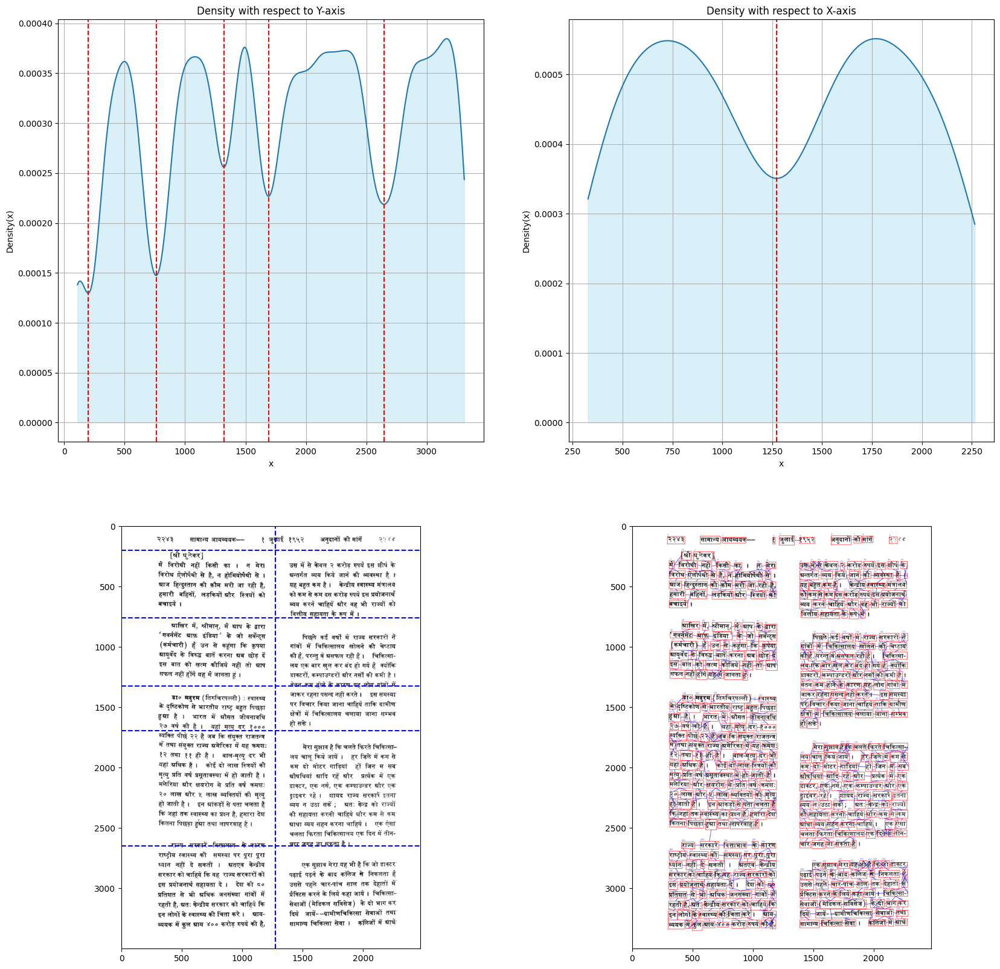

In [389]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 68
h=np.array([75,200])
connectImagewithThresholding(img_number=image_number,h=h)

- h1 = 100, h2 = 250

horizontal sections :  [ 760.45 1315.62 1696.81 2647.82]
vertical sections :  [1267.04]
Paragraphs and columns found! Now connecting words...


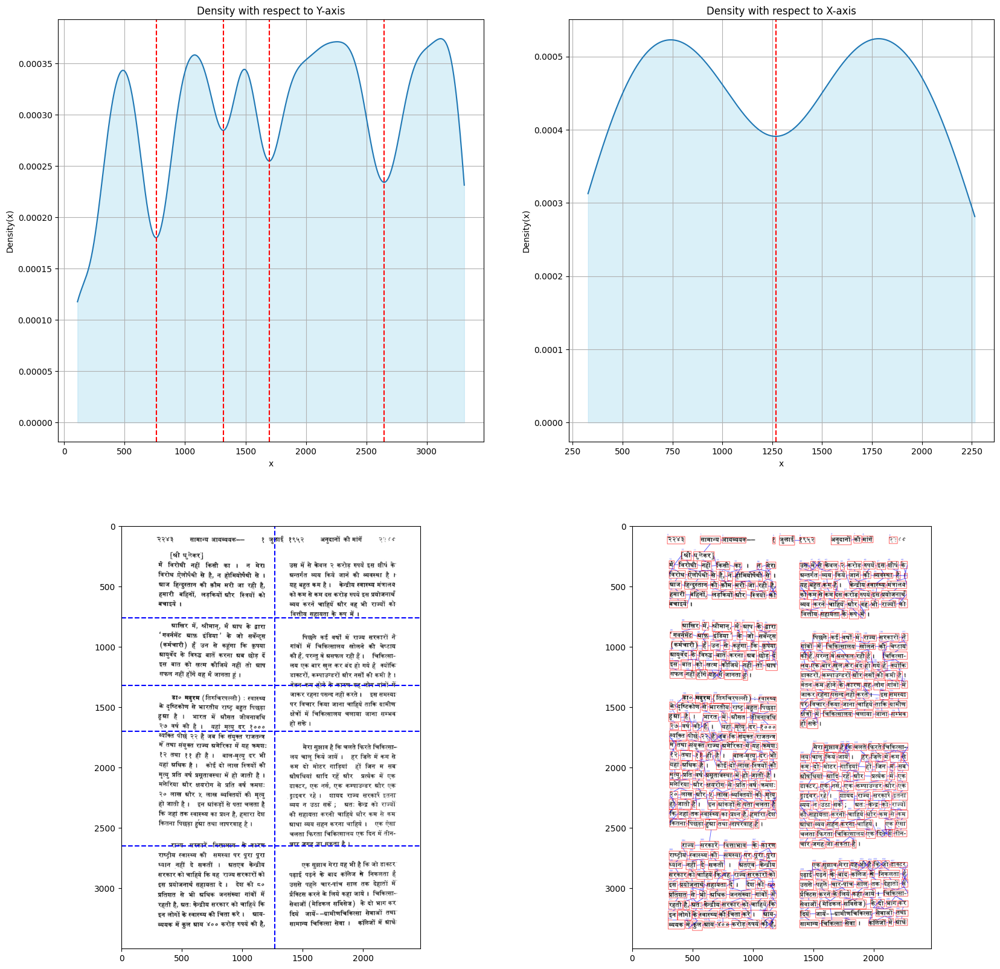

In [390]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
image_number = 68
h=np.array([100,250])
connectImagewithThresholding(img_number=image_number,h=h)

# Performing thresholding on all the given images (in question)

Doing Image  29
horizontal sections :  [ 451.81  856.23 1298.2  1617.89 1948.16 2395.91 2778.18]
vertical sections :  [1218.01]
Paragraphs and columns found! Now connecting words...


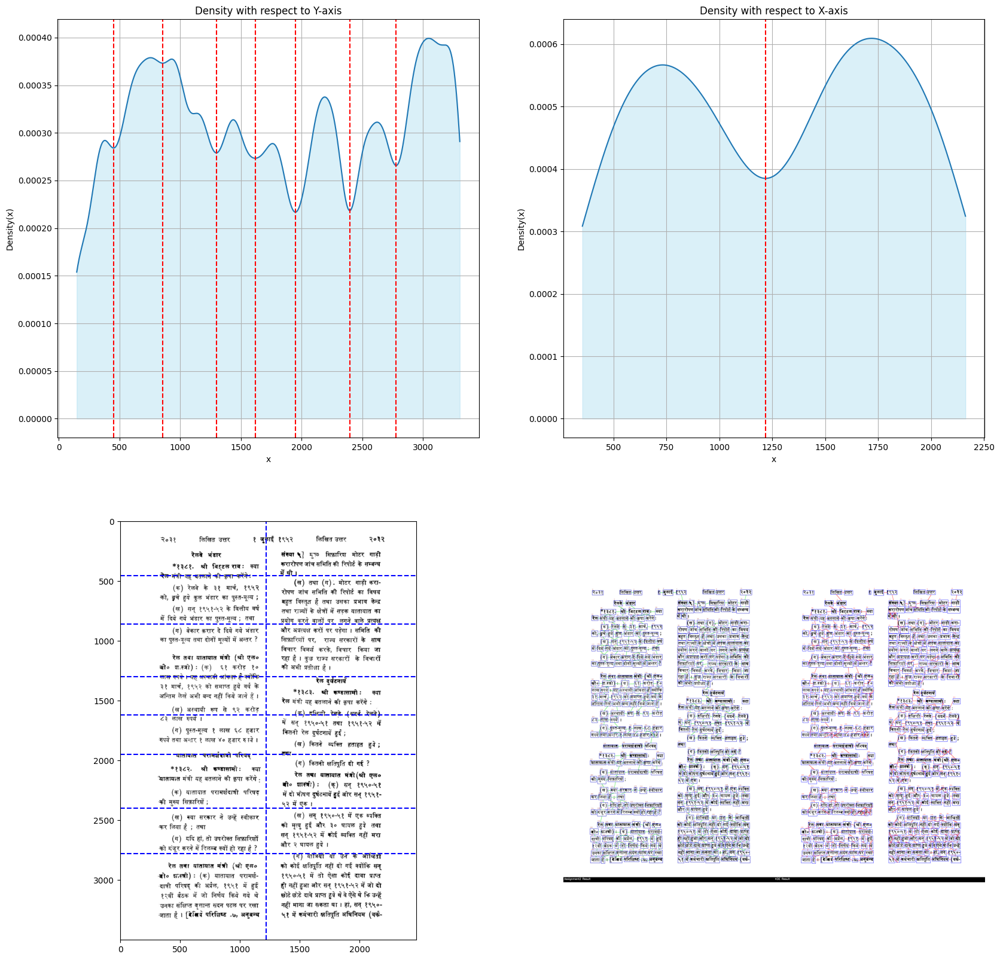

Doing Image  68
horizontal sections :  [ 198.44  760.45 1321.48 1690.94 2646.84]
vertical sections :  [1271.78]
Paragraphs and columns found! Now connecting words...


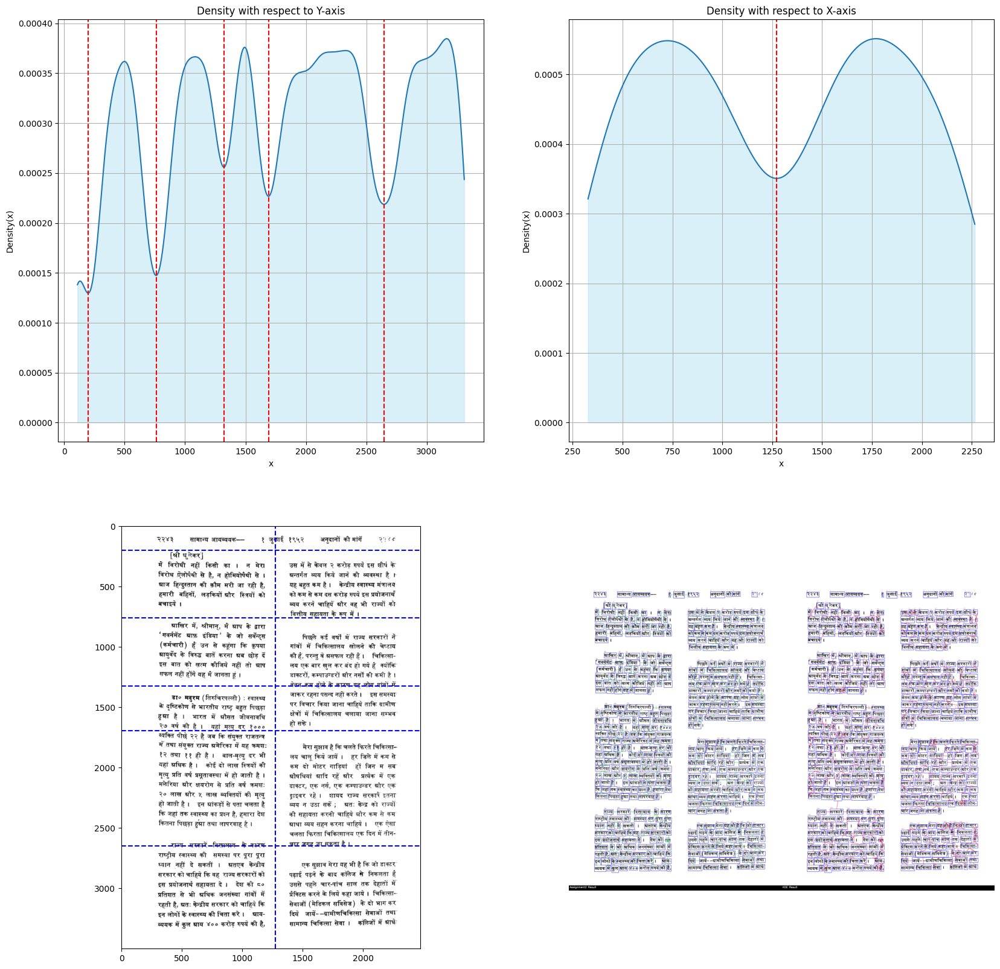

Doing Image  145
horizontal sections :  [ 710.32 1095.53 1521.34 2294.47]
vertical sections :  []
Paragraphs and columns found! Now connecting words...


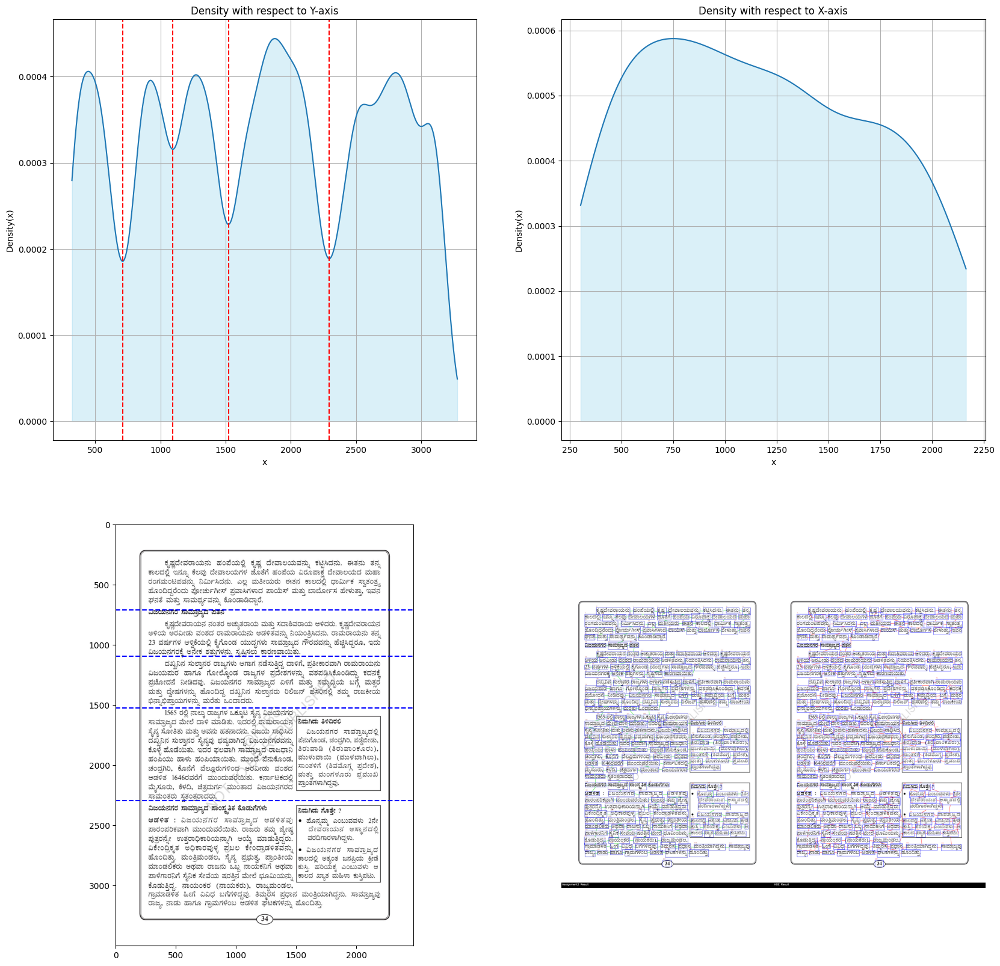

Doing Image  201
horizontal sections :  [ 327.14  706.3   998.82 1675.17 2616.09]
vertical sections :  [1413.62]
Paragraphs and columns found! Now connecting words...


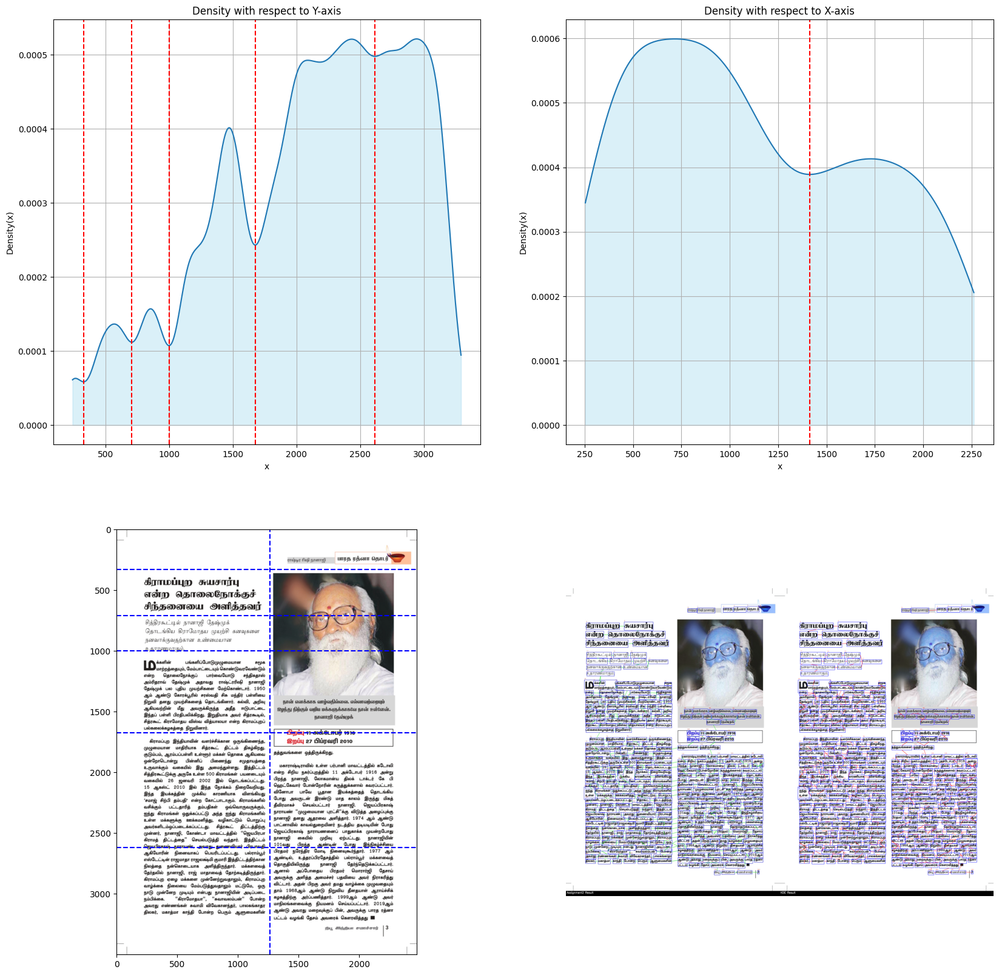

Doing Image  232
horizontal sections :  [ 781.42 1955.21 2435.16 2790.27 3118.77]
vertical sections :  [ 746.72 1624.01]
Paragraphs and columns found! Now connecting words...


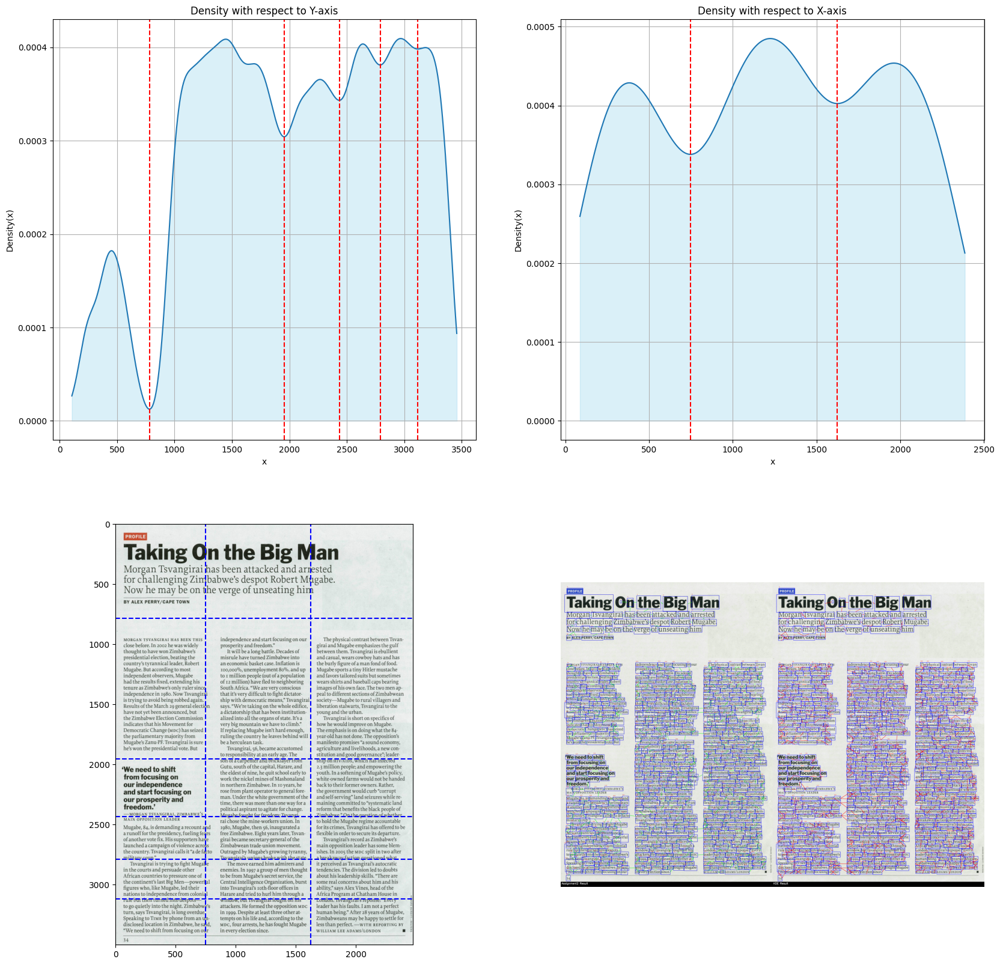

Doing Image  250
horizontal sections :  [ 537.85 1067.43 1415.18 1838.45 2210.05 2511.11 2784.35]
vertical sections :  [ 914.42 1584.87]
Paragraphs and columns found! Now connecting words...


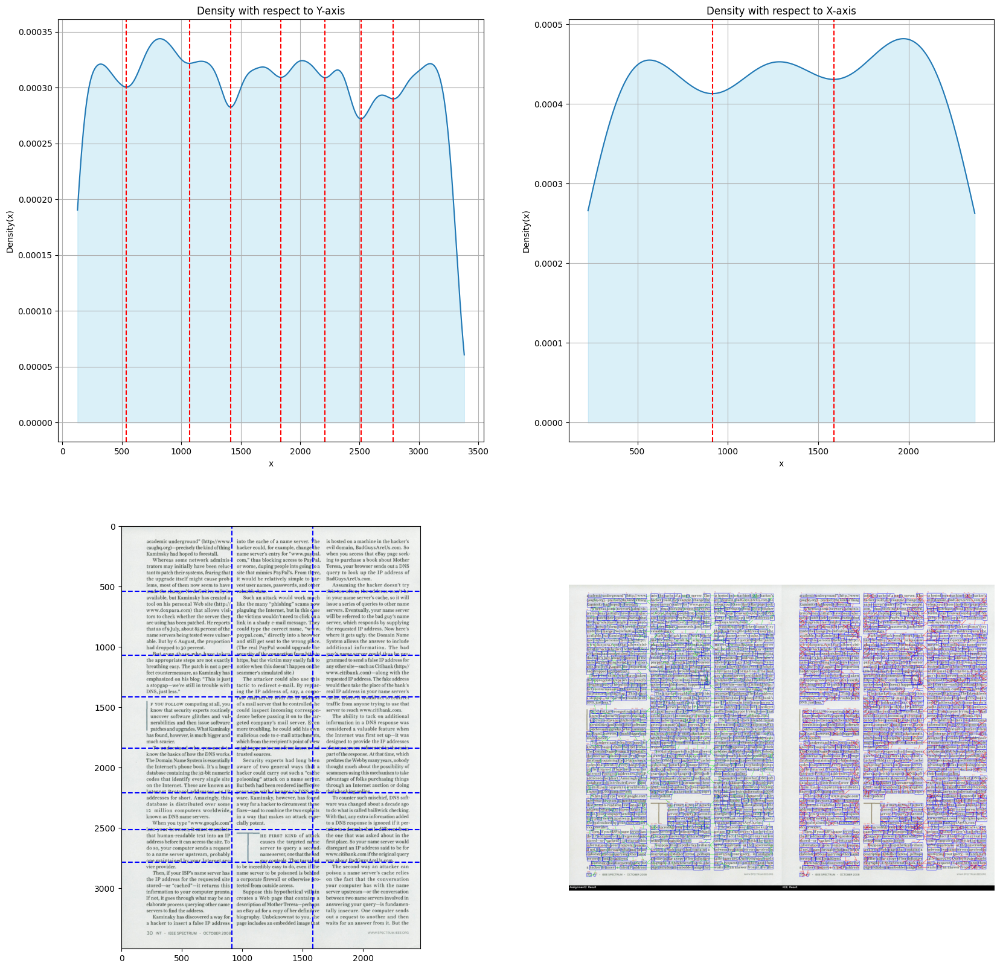

In [15]:
h=np.array([75,200])
image_list = np.array([29, 68, 145, 201, 232, 250])
for i_n in image_list:
    print('Doing Image ',i_n)
    fig, axes = plt.subplots(2, 2, figsize=(20, 20))
    image_number = i_n
    connectImagewithThresholding(img_number=image_number, h=h)